# Libraries

In [53]:
!pip install umap-learn

Defaulting to user installation because normal site-packages is not writeable


In [1]:
import pandas as pd
import numpy as np

from sklearn.preprocessing import StandardScaler

from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.decomposition import PCA, TruncatedSVD
from sklearn.manifold import TSNE
import umap

import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

# Data Load

In [55]:
iris = sns.load_dataset('iris')

In [56]:
iris.describe()

,sepal_length,sepal_width,petal_length,petal_width
count,150.000000,150.000000,150.000000,150.000000
mean,5.843333,3.057333,3.758000,1.199333
std,0.828066,0.435866,1.765298,0.762238
min,4.300000,2.000000,1.000000,0.100000
25%,5.100000,2.800000,1.600000,0.300000
50%,5.800000,3.000000,4.350000,1.300000
75%,6.400000,3.300000,5.100000,1.800000
max,7.900000,4.400000,6.900000,2.500000


In [57]:
px.scatter(
    iris,
    x='sepal_length',
    y='sepal_width',
    color='species',
)

In [58]:
px.scatter(
    iris,
    x='sepal_length',
    y='petal_length',
    color='species',
)

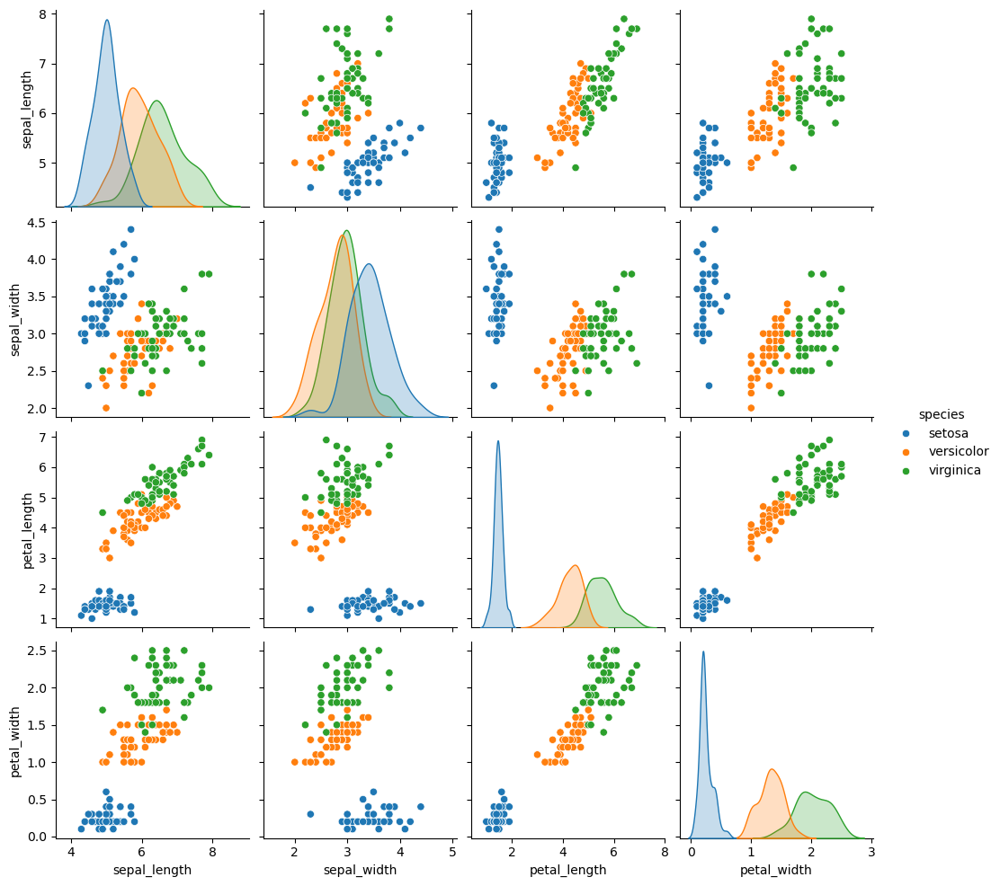

In [59]:
sns.pairplot(
    iris,
    hue='species'
)

In [60]:
px.scatter_3d(
    iris,
    x='petal_width',
    y='petal_length',
    z='sepal_length',
    color='species'
)

# Dimensional Reduction

feature가 많아지면 feature들 간의 관계 파악이 어려움 <br>
feature가 많으면 차원의 저주(Curse of Dimension)라고 불리우는 현상 발생 <br>
> **차원의 저주**: 데이터 학습을 위해 차원이 증가하면서 학습데이터 수가 차원의 수보다 적어져 성능이 저하되는 현상 <br>

차원 축소(dimensionality reduction)는 주요 feature를 선정하여 이를 해결 <br>
부수적인 효과로 feature의 수를 2, 3개로 줄여 각각 2D, 3D로 시각화 가능 <br>

<br>

<font style="font-size:20px"> 방법 </font>
1. Feature Elimination: feature 제거 <br>
-> 제거되는 feature에서 아무런 정보를 얻지 못 함. <br>
2. Feature Selection: 통계적 방법으로 feature 중요도에 rank 부여 <br>
-> information loss <br>
3. Feature Extraction: 새로운 독립적인 feature 생성 <br>

## LDA (Linear Discriminant Analysis)

<img src="https://miro.medium.com/v2/resize:fit:720/format:webp/1*uYeeaEwp9HVWENOCmrDyJA.png">

<br>

LDA는 입력 데이터를 저차원 공간으로 projection해 차원을 축소하는 기법. <br>
**지도학습**에서 사용. <br>

<br>

<font style="font-size:20px"> 동작 방법 </font>
1. projection 시 각 클래스에 속하는 데이터의 평균 간 거리의 합이 최대가 되는 벡터. <br>
    즉, 클래스 간(between-class)의 거리가 최대가 되는 벡터.
2. projection 시 각 클래스 내 데이터의 분산이 최소가 되게 하는 벡터. <br>
    즉, 클래스 내(within-class)의 분산이 최소가 되게 하는 벡터.

2의 벡터를 최소화 시키면서 1의 벡터를 최대화 시키는 벡터를 찾음 <br>
-> 클래스 간 분별 정보를 최대한 유지시키면서 차원 축소

<br>

<font style="font-size:20px"> 적용 순서 </font>
1. Scaling: 데이터가 가지고 있는 값으 범위를 균일하게 통일
2. 클래스 평균 계산
3. 클래스 내 산포 계산
4. 클래스 간 산포 계산
5. $ max_{\textbf{w}} \frac{\textbf{w}^TS_B\textbf{w}}{\textbf{w}^TS_W\textbf{w}} $
6. 선형판별벡터계산
7. 차원 축소 및 분류

<br>

<font style="font-size:20px"> 사용 방법 </font>
> ```python
> from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
> 
> lda = LinearDiscriminantAnalysis(n_components=2)
> lda.fit(X, y)
> transformed_X = lda.transform(X)
> ```

<br>

주요 파라미터
- n_estimators: 사용할 주성분의 수

In [71]:
lda = LinearDiscriminantAnalysis(n_components=2).fit(iris.iloc[:, :-1], iris.iloc[:, -1])

In [76]:
temp = pd.concat([
    pd.DataFrame(lda.transform(iris.iloc[:, :-1]), columns=['LDA1', 'LDA2']),
    iris.filter(items=['species'])
], axis=1)

In [77]:
px.scatter(
    temp,
    x='LDA1',
    y='LDA2',
    color='species'
)

C:\Users\USER\AppData\Local\Temp\ipykernel_21940\1733825421.py:7: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '0         1.0
1         1.0
2         1.0
3         3.0
4         3.0
         ... 
999995    1.0
999996    2.0
999997    1.0
999998    1.0
999999    1.0
Name: 흡연상태, Length: 993686, dtype: object' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.



<Axes: xlabel='LDA1', ylabel='LDA2'>

c:\ProgramData\anaconda3\Lib\site-packages\IPython\core\events.py:82: UserWarning:

Glyph 55137 (\N{HANGUL SYLLABLE HEUB}) missing from current font.

c:\ProgramData\anaconda3\Lib\site-packages\IPython\core\events.py:82: UserWarning:

Glyph 50672 (\N{HANGUL SYLLABLE YEON}) missing from current font.

c:\ProgramData\anaconda3\Lib\site-packages\IPython\core\events.py:82: UserWarning:

Glyph 49345 (\N{HANGUL SYLLABLE SANG}) missing from current font.

c:\ProgramData\anaconda3\Lib\site-packages\IPython\core\events.py:82: UserWarning:

Glyph 53468 (\N{HANGUL SYLLABLE TAE}) missing from current font.

c:\ProgramData\anaconda3\Lib\site-packages\IPython\core\pylabtools.py:170: UserWarning:

Glyph 55137 (\N{HANGUL SYLLABLE HEUB}) missing from current font.

c:\ProgramData\anaconda3\Lib\site-packages\IPython\core\pylabtools.py:170: UserWarning:

Glyph 50672 (\N{HANGUL SYLLABLE YEON}) missing from current font.

c:\ProgramData\anaconda3\Lib\site-packages\IPython\core\pylabtools.py:170: UserWarnin

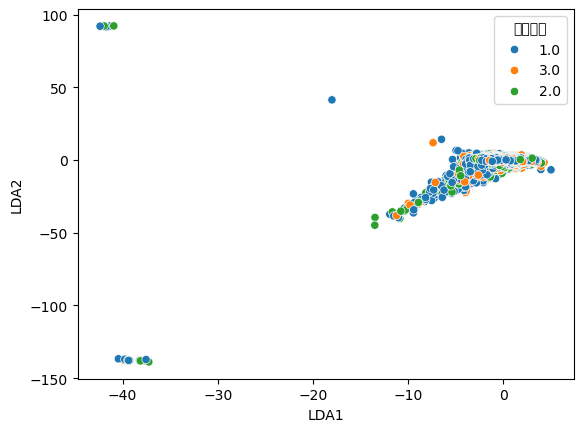

In [92]:
data = pd.read_csv('./data/국민건강보험공단_건강검진정보_2023.CSV', encoding='cp949')

lda = LinearDiscriminantAnalysis(n_components=2)
temp = data.filter(
    items=['신장(5cm단위)', '체중(5kg단위)', '허리둘레', '혈청지피티(ALT)', '감마지티피', '흡연상태'])
temp = temp.dropna()
temp.iloc[:, -1] = temp.iloc[:, -1].astype(str)
temp_lda_transformed = lda.fit_transform(temp.iloc[:, :-1], temp.iloc[:, -1])
temp_lda_transformed = pd.DataFrame(temp_lda_transformed, columns=['LDA1', 'LDA2'])
temp_lda_transformed = pd.concat([
    temp_lda_transformed,
    temp.iloc[:, -1:]
], axis=1)
sns.scatterplot(
    temp_lda_transformed,
    x='LDA1',
    y='LDA2',
    hue='흡연상태'
)

In [98]:
# 5번, 7번 연령코드의 흡연상태에 따라 데이터가 분류되는지 확인

sorted(data['연령대코드(5세단위)'].unique())

[5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18]

C:\Users\USER\AppData\Local\Temp\ipykernel_21940\976849479.py:7: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '5         1.0
6         1.0
14        1.0
22        1.0
24        1.0
         ... 
999952    1.0
999953    1.0
999955    1.0
999989    1.0
999998    1.0
Name: 흡연상태, Length: 124212, dtype: object' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.



<Axes: xlabel='LDA1', ylabel='LDA2'>

c:\ProgramData\anaconda3\Lib\site-packages\IPython\core\events.py:82: UserWarning:

Glyph 55137 (\N{HANGUL SYLLABLE HEUB}) missing from current font.

c:\ProgramData\anaconda3\Lib\site-packages\IPython\core\events.py:82: UserWarning:

Glyph 50672 (\N{HANGUL SYLLABLE YEON}) missing from current font.

c:\ProgramData\anaconda3\Lib\site-packages\IPython\core\events.py:82: UserWarning:

Glyph 49345 (\N{HANGUL SYLLABLE SANG}) missing from current font.

c:\ProgramData\anaconda3\Lib\site-packages\IPython\core\events.py:82: UserWarning:

Glyph 53468 (\N{HANGUL SYLLABLE TAE}) missing from current font.

c:\ProgramData\anaconda3\Lib\site-packages\IPython\core\pylabtools.py:170: UserWarning:

Glyph 55137 (\N{HANGUL SYLLABLE HEUB}) missing from current font.

c:\ProgramData\anaconda3\Lib\site-packages\IPython\core\pylabtools.py:170: UserWarning:

Glyph 50672 (\N{HANGUL SYLLABLE YEON}) missing from current font.

c:\ProgramData\anaconda3\Lib\site-packages\IPython\core\pylabtools.py:170: UserWarnin

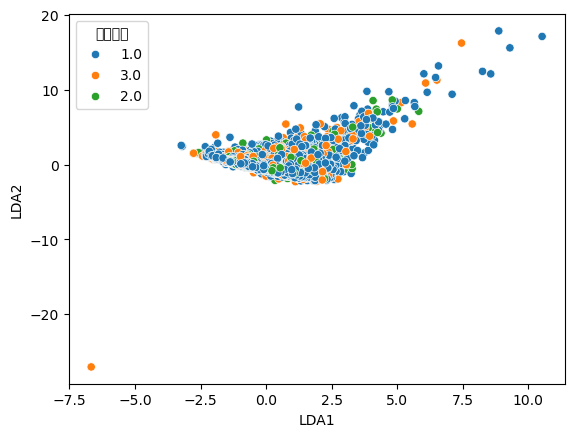

In [100]:
lda = LinearDiscriminantAnalysis(n_components=2)
temp = data.filter(
    items=['연령대코드(5세단위)', '신장(5cm단위)', '체중(5kg단위)', '허리둘레', '혈청지피티(ALT)', '감마지티피', '흡연상태'])
temp = temp.dropna()
temp = temp.query('`연령대코드(5세단위)` in [5, 7]')
temp = temp.drop(columns=['연령대코드(5세단위)'])
temp.iloc[:, -1] = temp.iloc[:, -1].astype(str)
temp_lda_transformed = lda.fit_transform(temp.iloc[:, :-1], temp.iloc[:, -1])
temp_lda_transformed = pd.DataFrame(temp_lda_transformed, columns=['LDA1', 'LDA2'])
temp_lda_transformed = pd.concat([
    temp_lda_transformed,
    temp.iloc[:, -1:]
], axis=1)
sns.scatterplot(
    temp_lda_transformed,
    x='LDA1',
    y='LDA2',
    hue='흡연상태'
)

## PCA (Principal Component Analysis)

<img src="https://cdn.prod.website-files.com/621e95f9ac30687a56e4297e/64adcad3f1a8195f54b8fa32_V2_1681216162455_637ea10c-2578-4213-b13f-9ef1e607a4fb_HIGH_RES.png" width="700" height="400">

<font style="font-size:20px"> 동작 방법 </font> <br>

데이터 분산을 최대화 할 수 있는 eigen vector로 projection

<br>

<font style="font-size:20px"> 적용 순서 </font>
1. Scaling: 데이터가 가지고 있는 값으 범위를 균일하게 통일
2. 평균 중심화: 각 feature의 평균을 빼서 평균이 0이 되도록 함
3. 공분산 행렬 계산: 변수 간 관계 정보를 파악할 수 있는 공분산 행렬 산출
4. 고윳값 분해: 변수 간 관계 정보를 최대한 유지할 수 있는 eigen vector 계산
5. 주성분 선택: 아래의 기준으로 주성분 선택
    - Eblow Point: Scree Plot에서 완만해지는 지점의 주성분 수를 선택
    - Kaiser's Rule: 고윳값이 1 이상인 주성분만 선택
    - 누적 설명률: 설명량이 70% ~ 80%가 되는 주성분 수 선택
6. 주성분 변환: 선택된 주성분을 기준으로 데이터 변환

sklearn의 pca는 2~6과정을 지원 <br>
- 주성분 선택은 하이퍼파라미터로 사전에 입력


<br>

<font style="font-size:20px"> 사용 방법 </font>

<font style="font-size:15px"> 주성분 수 </font>
> ```python
> from sklearn.decomposition import PCA
> 
> pca = PCA()
> pca.fit(X)
> 
> explained_variance_ratio = pca.explained_variance_ratio_
> cumulative_variance_ratio = np.cumsum(explained_variance_ratio)
>
> ### Scree Plot
> plt.figure(figsize=(8, 6))
> plt.plot(
>    range(1, len(explained_variance_ratio) + 1),
>    explained_variance_ratio,
>    marker='o',
>    linestyle='--',
>    color='b',
>    label='Explained Variance Ratio'),
> )
> plt.plot(
>    range(1, len(explained_variance_ratio) + 1),
>    cumulative_variance_ratio,
>    marker='o',
>    linestyle='-',
>    color='r',
>    label='Cumulative Explained Variance Ratio',
> )
> plt.title('Scree Plot')
> plt.xlabel('Principal Component')
> plt.ylabel('Explained Variance Ratio')
> plt.xticks(range(1, len(explained_variance_ratio) + 1))
> plt.legend()
> plt.show()
>
> ### Kaiser's Rule
> n_components = len(np.where(pca.explained_variance_ >= 1)[0])
>
> ### 누적 설명률
> pca.explained_variance_ratio_.cumsum()
> ```


<font style="font-size:15px"> PCA 적용 </font>


> ```python
> from sklearn.decomposition import PCA
> 
> pca = PCA(n_components=2)
> transformed_X = pca.fit_transform(X)
> ```

<br>

주요 파라미터
- n_estimators: 사용할 주성분의 수

In [61]:
pca = PCA(n_components=2)
iris_pca_transformed = pd.DataFrame(pca.fit_transform(iris.iloc[:, :4]), columns=['PC1', 'PC2'])
iris_pca_transformed = pd.concat([
    iris_pca_transformed,
    iris.filter(items=['species']),
], axis=1)

In [62]:
px.scatter(
    iris_pca_transformed,
    x='PC1',
    y='PC2',
    color='species'
)

In [63]:
# 분산량 확인
pca = PCA(n_components=4)
pca.fit(iris.iloc[:, :-1])
pca.explained_variance_ratio_

array([0.92461872, 0.05306648, 0.01710261, 0.00521218])

In [64]:
pca.explained_variance_ # eigenvalues

array([4.22824171, 0.24267075, 0.0782095 , 0.02383509])

In [65]:
pca.explained_variance_ / pca.explained_variance_.sum()

array([0.92461872, 0.05306648, 0.01710261, 0.00521218])

누적설명률

In [66]:
pca.explained_variance_.cumsum() / pca.explained_variance_.sum()

array([0.92461872, 0.97768521, 0.99478782, 1.        ])

In [67]:
px.scatter(
    iris_pca_transformed.assign(axis='PC1'),
    x='axis',
    y='PC1',
    color='species'
)

Text(0, 0.5, 'Explained Vaiance Ratio')

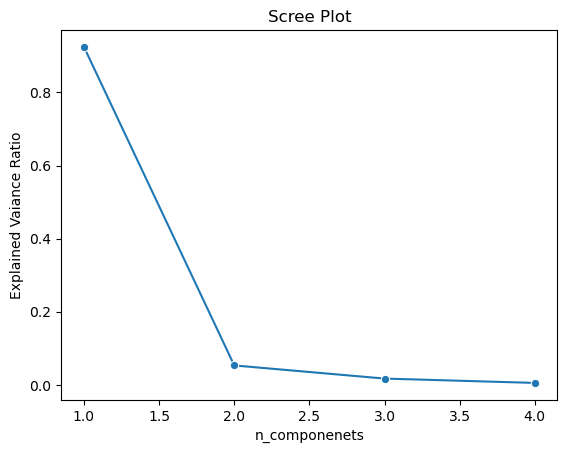

In [68]:
sns.lineplot(
    x=np.arange(1, len(pca.explained_variance_)+1),
    y=pca.explained_variance_ratio_,
    marker='o',
)
plt.title('Scree Plot')
plt.xlabel('n_componenets')
plt.ylabel('Explained Vaiance Ratio')

In [69]:
data = pd.read_csv('./data/국민건강보험공단_건강검진정보_2023.CSV', encoding='cp949')

<Axes: xlabel='PC1', ylabel='PC2'>

c:\ProgramData\anaconda3\Lib\site-packages\IPython\core\events.py:82: UserWarning:

Glyph 55137 (\N{HANGUL SYLLABLE HEUB}) missing from current font.

c:\ProgramData\anaconda3\Lib\site-packages\IPython\core\events.py:82: UserWarning:

Glyph 50672 (\N{HANGUL SYLLABLE YEON}) missing from current font.

c:\ProgramData\anaconda3\Lib\site-packages\IPython\core\events.py:82: UserWarning:

Glyph 49345 (\N{HANGUL SYLLABLE SANG}) missing from current font.

c:\ProgramData\anaconda3\Lib\site-packages\IPython\core\events.py:82: UserWarning:

Glyph 53468 (\N{HANGUL SYLLABLE TAE}) missing from current font.

c:\ProgramData\anaconda3\Lib\site-packages\IPython\core\pylabtools.py:170: UserWarning:

Glyph 55137 (\N{HANGUL SYLLABLE HEUB}) missing from current font.

c:\ProgramData\anaconda3\Lib\site-packages\IPython\core\pylabtools.py:170: UserWarning:

Glyph 50672 (\N{HANGUL SYLLABLE YEON}) missing from current font.

c:\ProgramData\anaconda3\Lib\site-packages\IPython\core\pylabtools.py:170: UserWarnin

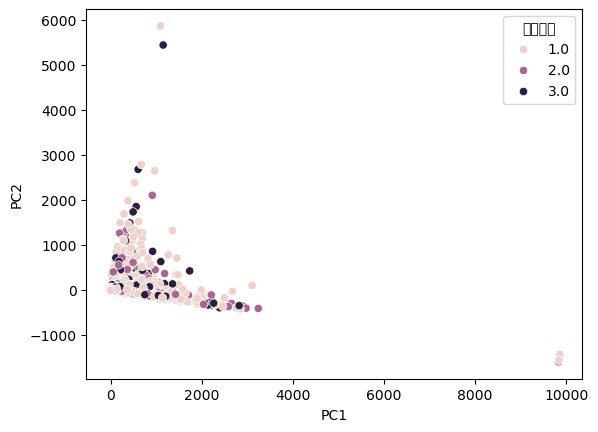

In [93]:
# 음주 여부에 따른 신장, 체중, 허리둘레,
# 혈청지피티(ALT), 감마지티피의 정보에 차이가 존재하는지 확인하려고 한다
# 5개의 정보를 축소하여 건강 정보에 유의한 차이가 있는지 확인
pca = PCA(n_components=2)
temp = data.filter(
    items=['신장(5cm단위)', '체중(5kg단위)', '허리둘레', '혈청지피티(ALT)', '감마지티피', '흡연상태'])
temp = temp.dropna()
temp_pca_transformed = pca.fit_transform(temp.iloc[:, :-1])
temp_pca_transformed = pd.DataFrame(temp_pca_transformed, columns=['PC1', 'PC2'])
temp_pca_transformed = pd.concat([
    temp_pca_transformed,
    temp.iloc[:, -1:]
], axis=1)
sns.scatterplot(
    temp_pca_transformed,
    x='PC1',
    y='PC2',
    hue='흡연상태'
)

## t-SNE (t-distributed Stochastic Neighbor Embedding)

### Manifold

데이터가 존재하는 공간 <br>
매니폴드 가정 중 데이터가 고차원이라고 하여도 이 집합을 포함하는 저차원 manifold가 존재 <br>
-> 고차원 데이터일지라도 저차원 manifold 상에 위치할 수 있으며, 낮은 차원의 manifold를 벗어나면 데이터 밀도가 낮아짐

<img src="https://postfiles.pstatic.net/MjAxODEyMTJfNDUg/MDAxNTQ0NjEwNjkzMjk5.eKNub3DHfRLd-lP71HoBtKP0H255lCUne4SGeAFuXssg.jb0hhhoVegPiWKrrIxSqIuRoM5Yjx70UjZwgxCoFM30g.PNG.coniecual/image.png?type=w773" width="700" height="400">

말려있는 roll을 풀면 저차원의 manifold로 표현 가능

<br>
<br>

<img src="https://postfiles.pstatic.net/MjAxODEyMTJfNzMg/MDAxNTQ0NjEwNzg5NzU3.8sfp6Z4ZhP9YMmdaF-iBgM7PjpY_KVrouKk1CFklPZog.mB3FBfOVKS-eScJ3ORtgqW8lr1Jd4lzqIqHP2hLfnMsg.PNG.coniecual/image.png?type=w773" width="700" height="400">

<img src="https://postfiles.pstatic.net/MjAxODEyMTJfNiAg/MDAxNTQ0NjEwODA5NTIx.usAGRV1c7lMM52ps0QiQSXliTa16v81kqimpvsnaLKYg.EY9G-EfTZaPbvOb2Sa9BZ6QjBs9itrHYr8mTPtF9560g.PNG.coniecual/image.png?type=w773" width="700" height="400">

<img src="https://postfiles.pstatic.net/MjAxODEyMTJfMTYz/MDAxNTQ0NjEwOTA5NTQy.bvb5VlEsdqarYDTPD_JB3Za-4PxYsOyMWxbSY8J0ieYg.rS_kG6OpqfnhE3qhG-qt-3OiBQPmjw1uTiT8qmKwUU0g.PNG.coniecual/image.png?type=w773" width="700" height="400">

고차원 상에서 가까운 데이터가 저차원 manifold에서 가깝지 않을 수 있음 <br>
반대로 저차원 데이터 상에서 가까운 데이터가 보다 의미상으로 가까움 <br>

### t-SNE

<font style="font-size:20px"> 동작 방법 </font> <br>
1. 각 데이터 포인트 간 유사도 계산
2. 저차원에서 유사도 계산
3. 저차원과 고차원의 유사도 분포를 근사  
  Kullback-Leibler(KL) divergence를 비용함수로 정의 후 Gradient Descent를 통해 최소화


<br>

<font style="font-size:20px"> 사용 방법 </font>
> ```python
> from sklearn.manifold import TSNE
> 
> t_sne = TSNE(n_components=2)
> transformed_X = t_sne.fit_transform(X)
> ```

<br>

주요 파라미터
- n_estimators: 사용할 차원의 수

In [126]:
t_sne = TSNE(n_components=2, random_state=9)
iris_tsne_transfomred = t_sne.fit_transform(iris.iloc[:, :-1])
iris_tsne_transfomred = pd.DataFrame(iris_tsne_transfomred, columns=['TSNE1', 'TSNE2'])
iris_tsne_transfomred = pd.concat([
    iris_tsne_transfomred,
    iris.filter(items=['species'])
], axis=1)

px.scatter(
    iris_tsne_transfomred,
    x='TSNE1',
    y='TSNE2',
    color='species'
)

## UMAP (Uniform Manifold Approximation and Projection)

<img src="https://umap-learn.readthedocs.io/en/latest/_images/how_umap_works_basic_graph.png" width="700" height="400">

데이터의 위상 관계를 이용하여 저차원으로 매핑

<br>

<font style="font-size:20px"> 동작 방법 </font> <br>
1. 주어진 metric 기반으로 각 데이터 포인트마다 가까운 이웃(neighbor)을 찾음
2. 이웃 간 거리를 계산
3. MST(Minimum Spanning Tree) 구성
4. 상대적 거리를 최대한 보존하면서 저차원으로 매핑


<br>

<font style="font-size:15px"> 사용 방법 </font>
> ```python
> import umap
> 
> reducer = umap.UMAP()
> transformed_X = reducer.fit_transform(X)
> ```

<br>

주요 파라미터
- n_estimators: 사용할 차원의 수

In [139]:
umap = umap.UMAP(n_components=2, random_state=9)
iris_umap_transfomred = umap.fit_transform(iris.iloc[:, :-1])
iris_umap_transfomred = pd.DataFrame(iris_umap_transfomred, columns=['umap1', 'umap2'])
iris_umap_transfomred = pd.concat([
    iris_umap_transfomred,
    iris.filter(items=['species'])
], axis=1)

px.scatter(
    iris_umap_transfomred,
    x='umap1',
    y='umap2',
    color='species'
)

C:\Users\USER\AppData\Roaming\Python\Python312\site-packages\umap\umap_.py:1945: UserWarning:

n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.



## SVD (Singular Value Decomposition)

<img src="https://img1.daumcdn.net/thumb/R1280x0/?scode=mtistory2&fname=https%3A%2F%2Fblog.kakaocdn.net%2Fdn%2FbsLJ5A%2FbtqBZqJMY8P%2FdvxOlSuKMEg1OPgZXde7u1%2Fimg.png" width="700" height="400">

<br>
<br>

<img src="https://wikidocs.net/images/page/24949/svd%EC%99%80truncatedsvd.PNG">

<br>

행렬 분해를 통해 차원 축소 등을 수행

<br>

<font style="font-size:15px"> Equation </font>

$ \textbf{A} = U \Sigma V^T $
where,
$A$는 원래 행렬 <br>
$U$: $m×m$ 직교 행렬 <br> 
$\Sigma$: $m×n$ 대각 행렬(주대각 성분에는 특이값이 정렬되어 있음) <br>
$V$: $n×n$ 직교 행렬 <br>

<br>

<font style="font-size:15px"> 사용 방법 </font>
```python
from sklearn.decomposition import TruncatedSVD

svd = TruncatedSVD(n_components=2, n_iter=5, random_state=42)
transformed_X = svd.fit_transform(X)
```

주요 파라미터
- n_estimators: 사용할 차원의 수
- n_iter: solver가 수행할 반복 횟수
- random_state: 난수 고정을 위한 seed

In [140]:
truncated_svd = TruncatedSVD(n_components=2, random_state=9)
iris_svd_transfomred = truncated_svd.fit_transform(iris.iloc[:, :-1])
iris_svd_transfomred = pd.DataFrame(iris_svd_transfomred, columns=['svd1', 'svd2'])
iris_svd_transfomred = pd.concat([
    iris_svd_transfomred,
    iris.filter(items=['species'])
], axis=1)

px.scatter(
    iris_svd_transfomred,
    x='svd1',
    y='svd2',
    color='species'
)

# Practice

In [173]:
## 1.
# 서울시 대기질 자료 제공_2022
air_quality = pd.read_csv('./data/서울시 대기질 자료 제공_2022.csv', encoding='cp949').dropna()
# 1. label 생성
# 진짜 나쁨	: 둘 다 76이상
# 나쁨      : 하나만 76 이상
# 보통      : 해당 없음

air_quality['pm10_label'] = np.where(air_quality['미세먼지(PM10)'] > 76, 1, 0)
air_quality['pm25_label'] = np.where(air_quality['초미세먼지(PM2.5)'] > 76, 1, 0)
air_quality['label'] = (air_quality.pm10_label + air_quality.pm25_label).astype(str)

# 2. 1차원에서 레이블 별 분포가 다른지 확인
pca = PCA(n_components=1)
air_quality_tsne_transformed = pd.DataFrame(pca.fit_transform(air_quality.iloc[:, 2:4]), columns=['pca1'])
air_quality_tsne_transformed = pd.concat([
    air_quality_tsne_transformed,
    air_quality.filter(items=['label'])
], axis=1)

px.scatter(
    air_quality_tsne_transformed.assign(temp='1'),
    x='temp',
    y='pca1',
    color='label'
)

In [174]:
px.box(
    air_quality_tsne_transformed.assign(temp='1'),
    x='label',
    y='pca1',
)

In [86]:
## 2.
# 1. 주식 데이터의 종가, 일자 로드
celltrion_2021 = pd.read_csv('./data/celltron_2021.csv', encoding='cp949', usecols=['일자', '종가'])
celltrion_2023 = pd.read_csv('./data/celltron_2023.csv', encoding='cp949', usecols=['일자', '종가'])
hynix_2021 = pd.read_csv('./data/hynix_2021.csv', encoding='cp949', usecols=['일자', '종가'])
hynix_2023 = pd.read_csv('./data/hynix_2023.csv', encoding='cp949', usecols=['일자', '종가'])
samsung_2021 = pd.read_csv('./data/samsung_2021.csv', encoding='cp949', usecols=['일자', '종가'])
samsung_2023 = pd.read_csv('./data/samsung_2023.csv', encoding='cp949', usecols=['일자', '종가'])

# 2. 데이터 열을 삼성, 하이닉스, 셀트리온의 종가와 일자를 새로운 데이터프레임 생성
## 방법1
df_2021 = pd.concat([
    celltrion_2021.rename(columns={'종가': 'celltrion'}),
    hynix_2021.rename(columns={'종가': 'hynix'}).drop(columns=['일자']),
    samsung_2021.rename(columns={'종가': 'samsung'}).drop(columns=['일자']),
    ],
    axis=1,
)

df_2023 = pd.concat([
    celltrion_2023.rename(columns={'종가': 'celltrion'}),
    hynix_2023.rename(columns={'종가': 'hynix'}).drop(columns=['일자']),
    samsung_2023.rename(columns={'종가': 'samsung'}).drop(columns=['일자']),
    ],
    axis=1,
)

df = pd.concat([df_2021, df_2023])

## 방법2
# (
#     celltrion_2021.rename(columns={'종가': 'celltrion'})
#     .merge(hynix_2021.rename(columns={'종가': 'hynix'}), on=['일자'])
#     .merge(samsung_2021.rename(columns={'종가': 'samsung'}), on=['일자'])
# )

## 방법3
# df_2021 = pd.concat([
#     celltrion_2021.set_index('일자').rename(columns={'종가': 'celltrion'}),
#     hynix_2021.set_index('일자').rename(columns={'종가': 'hynix'}),
#     samsung_2021.set_index('일자').rename(columns={'종가': 'samsung'}),
# ], axis=1)

# df_2023 = pd.concat([
#     celltrion_2023.set_index('일자').rename(columns={'종가': 'celltrion'}),
#     hynix_2023.set_index('일자').rename(columns={'종가': 'hynix'}),
#     samsung_2023.set_index('일자').rename(columns={'종가': 'samsung'}),
# ], axis=1)

# df = pd.concat([df_2021, df_2023])



# 3. 레이블로 2021, 2023 생성
## 방법1
df_2021 = pd.concat([
    celltrion_2021.rename(columns={'종가': 'celltrion'}),
    hynix_2021.rename(columns={'종가': 'hynix'}).drop(columns=['일자']),
    samsung_2021.rename(columns={'종가': 'samsung'}).drop(columns=['일자']),
    ],
    axis=1,
)

df_2023 = pd.concat([
    celltrion_2023.rename(columns={'종가': 'celltrion'}),
    hynix_2023.rename(columns={'종가': 'hynix'}).drop(columns=['일자']),
    samsung_2023.rename(columns={'종가': 'samsung'}).drop(columns=['일자']),
    ],
    axis=1,
)

df = pd.concat([df_2021, df_2023])

# df.일자 = df.일자.apply(lambda x: x[:4])
# df.일자 = df.일자.apply(lambda x: str.split(x, '/')[0])
df.일자 = df.일자.str.split('/').explode().iloc[::3]
# df.일자 = df.일자.str.extract('(^\d{4})', expand=False)

## 방법2
# 방법1과 동일

## 방법3
# df.index = [x[0] for x in df.index.str.split('/')]
# df.index = df.index.str.extract('(^\d{4})', expand=False)

# 4. 삼성, 하이닉스, 셀트리온의 종가 정보를 차원 축소를 통해 2차원으로 변환
## 방법1, 2
df = pd.concat([
    df.filter(items=['일자']).reset_index(drop=True),
    pd.DataFrame(
        TSNE(n_components=2).fit_transform(df.iloc[:, 1:]),
        columns=['tsne1', 'tsne2'],
    )
], axis=1)

## 방법3
# df = pd.concat([
#     pd.DataFrame(df.index, columns=['일자']),
#     pd.DataFrame(
#         TSNE(n_components=2).fit_transform(df),
#         columns=['tsne1', 'tsne2'],
#     )
# ], axis=1)

# 5. 변환된 데이터를 레이블 별로 다른 색을 주어 시각화
px.scatter(
    df,
    x='tsne1',
    y='tsne2',
    color='일자',
)